In [1]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sys
sys.path.append('../')
from game.Bankgames import *
from game.plotting import *
from game.distributions import TruncatedGaussian, Uniform, PiecewiseUniform
import nashpy as nh
from tqdm import tqdm
import pandas as pd
import os

In [2]:
from openpyxl import Workbook
from openpyxl.drawing.image import Image

In [3]:
def are_arrays_equal(arr1_list, arr2, tolerance=1e-5):
    """
    Check if arr2 matches any array in arr1_list within the given tolerance.
    
    Parameters:
    arr1_list: List of arrays to compare against
    arr2: Single array to compare with each array in arr1_list
    tolerance: Threshold for numerical comparison
    
    Returns:
    bool: True if arr2 matches any array in arr1_list
    """
    arr2_clean = np.where(np.abs(arr2) < tolerance, 0, arr2)
    return any(np.allclose(np.where(np.abs(arr1) < tolerance, 0, arr1), arr2_clean, rtol=tolerance, atol=tolerance)
               for arr1 in arr1_list)

def run_game_for_row(row, p_b1, p_b2, eta, output_dir = '2x2plots', T=5000, dist = 'pu'):
    """
    Run the game for a single row of the sampled dataframe, and save results.
    
    Parameters:
    - row: Row from the sampled dataframe containing gamma_l, gamma_h, and other relevant data
    - T, p_b1, p_b2, eta: Parameters for the game simulation
    - output_dir: Directory where plots and results will be saved
    
    Returns:
    - A tuple containing (eps1, eps2, b1_last, b2_last, plot_filename)
    """
        # Extract gamma values from the row
    gamma_l = row['gamma_l']
    gamma_h = row['gamma_h']
    
    # Initialize PiecewiseUniform and GameTrueMatrix2by2 objects
    gammas = sorted([gamma_l, gamma_h])
    taus = sorted([1 / (2 + gamma) for gamma in gammas])
    
    if dist == 'pu':
        puf = PiecewiseUniform(ga_l=gammas[0], ga_h=gammas[1])  
        gtm = GameTrueMatrix2by2(gammas=gammas, taus=taus, dist=puf)
        gfe = GameFreshEstimate(gammas=gammas, taus=taus, dist=puf, num_samples=1)
        gma = GameMovingAvg(gammas=gammas, taus=taus, dist=puf, num_samples=1) 
        
        # Run the game simulation
        game_results = [gtm.run_hedge(T=T, p_b1=p_b1, p_b2=p_b2, eta=eta)]
        b1, b2, gammas, taus = game_results[0]
        game_results.append(gfe.run_hedge(T=T, p_b1=p_b1, p_b2=p_b2, eta=eta))
        b1_fe,b2_fe, gammas,taus = game_results[1]
        game_results.append(gma.run_hedge(T=T, p_b1=p_b1, p_b2=p_b2, eta=eta))
        b1_ma,b2_ma, gammas,taus = game_results[2]
        
        plot_filename = os.path.join(output_dir, f"plot_case_{row['case']}_{row['gamma_l']}_{row['gamma_h']}.png")
    elif dist == 'tg':
        mu = row['mu']
        sigma = row['sigma']
        tg = TruncatedGaussian(mu = mu, sigma = sigma)
        gtm = GameTrueMatrix2by2(gammas=gammas, taus=taus, dist=tg)
        gfe = GameFreshEstimate(gammas=gammas, taus=taus, dist=tg, num_samples=1)
        gma = GameMovingAvg(gammas=gammas, taus=taus, dist=tg, num_samples=1)
        
        # Run the game simulation
        game_results = [gtm.run_hedge(T=T, p_b1=p_b1, p_b2=p_b2, eta=eta)]
        b1, b2, gammas, taus = game_results[0]
        game_results.append(gfe.run_hedge(T=T, p_b1=p_b1, p_b2=p_b2, eta=eta))
        b1_fe,b2_fe,gammas,taus = game_results[1]
        game_results.append(gma.run_hedge(T=T, p_b1=p_b1, p_b2=p_b2, eta=eta))
        b1_ma,b2_ma,gammas,taus = game_results[2]
        
        plot_filename = os.path.join(output_dir, f"plot_case_{row['case']}_mu:{mu},sig:{sigma}_{row['gamma_l']}_{row['gamma_h']}.png")
    
    
    # Get the results
    theoryNE = gtm.NE_theory
    b1_last = b1[-1]
    b2_last = b2[-1]
    
    b1_fe_last = b1_fe[-1]
    b2_fe_last = b2_fe[-1]
    
    b1_ma_last = b1_ma[-1]
    b2_ma_last = b2_ma[-1]
    
    #print([b1_fe_last,b2_fe_last])
    #print([b1_ma_last,b2_ma_last])
    
    convCheck_true = are_arrays_equal(theoryNE,[b1_last,b2_last])
    convCheck_fe = are_arrays_equal(theoryNE,[b1_fe_last,b2_fe_last])
    convCheck_ma = are_arrays_equal(theoryNE,[b1_ma_last,b2_ma_last])
    
    # Generate the plot and get the image
    
    image = plot_multiple_game_probabilities(game_results, titles=['True Payoff','Fresh Estimate','Moving Average'], figsize=(15, 10), display=False)
    #plot_game_probability_single((b1, b2, gammas, taus))

    
    image.save(plot_filename)
        
    # Show the plot inline (in Jupyter)
    #plt.show()
    
    return convCheck_true,convCheck_fe,convCheck_ma, theoryNE, b1, b2, b1_fe, b2_fe, b1_ma, b2_ma, plot_filename



In [4]:
def process_sampled_df(sampled_df, p_b1, p_b2, eta, fname, output_dir='2x2plots', T=5000, dist = 'pu'):
    """
    Process the sampled dataframe, run the game for each row, and save results to a new workbook.
    
    Parameters:
    - sampled_df: DataFrame containing the rows of the sample
    - p_b1, p_b2, eta: Parameters for the game simulation
    - output_dir: Directory to save plots and results
    - T: Number of iterations for the game simulation
    
    Returns:
    - None, but saves an Excel workbook with results and a corresponding PNG plot for each row
    """
    # Create the output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)
    
    # Create a new Excel workbook
    wb = Workbook()
    ws = wb.active
    ws.title = "Results"
    
    # Define the headers for the Excel file
    if dist == 'pu':
        headers = [
        'case', 'gamma_l', 'gamma_h', 
        'convCheck_true', 'convCheck_fe', 'convCheck_ma', 
        'theoryNE', 
        'b1_b2', 'b1_b2_fe', 'b1_b2_ma', 
        'plot_image'
        ]
    else:
        headers = [
        'case', 'mu','sigma','gamma_l', 'gamma_h', 
        'convCheck_true', 'convCheck_fe', 'convCheck_ma', 
        'theoryNE', 
        'b1_b2', 'b1_b2_fe', 'b1_b2_ma',
        'plot_image'
        ]
    ws.append(headers)

    # Process each row in the sampled dataframe
    for idx, row in sampled_df.iterrows():
        # Run the game for the current row
        if dist == 'pu':
            convCheck_true, convCheck_fe, convCheck_ma, theoryNE, b1_last, b2_last, b1_fe_last, b2_fe_last, b1_ma_last, b2_ma_last, plot_filename = run_game_for_row(
                row, p_b1=p_b1, p_b2=p_b2, eta=eta, output_dir=output_dir, T=T
            )

            # Combine the results with the original row data
            result_row = [
                row['case'], row['gamma_l'], row['gamma_h'], 
                convCheck_true, convCheck_fe, convCheck_ma, 
                str(theoryNE), 
                str([[b1_last, b2_last]]), 
                str([[b1_fe_last, b2_fe_last]]), 
                str([[b1_ma_last, b2_ma_last]])
            ]
        elif dist == 'tg':
            convCheck_true, convCheck_fe, convCheck_ma, theoryNE, b1_last, b2_last, b1_fe_last, b2_fe_last, b1_ma_last, b2_ma_last, plot_filename = run_game_for_row(
                row, p_b1=p_b1, p_b2=p_b2, eta=eta, output_dir=output_dir, T=T, dist = 'tg'
            )

            # Combine the results with the original row data
            result_row = [
                row['case'], row['mu'], row['sigma'], row['gamma_l'], row['gamma_h'], 
                convCheck_true, convCheck_fe, convCheck_ma, 
                str(theoryNE), 
                str([[b1_last, b2_last]]), 
                str([[b1_fe_last, b2_fe_last]]), 
                str([[b1_ma_last, b2_ma_last]])
            ]
            #print(result_row)
        
        # Save the plot image into the workbook
        plot_image = Image(plot_filename)
        plot_image.width = 300  # Optional: Adjust the size
        plot_image.height = 200  # Optional: Adjust the size
        
        # Add the image into the sheet (placing it in a cell, e.g., D2, D3, etc.)
        cell = f'T{idx + 2}'  # Start at row 2, column G for images (adjust as necessary)
        ws.add_image(plot_image, cell)
        
        # Append the result row into the workbook (excluding the plot filename)
        ws.append(result_row)  # Append all columns except plot_filename
    
    # Save the results to an Excel workbook
    output_workbook = os.path.join(output_dir, fname)
    wb.save(output_workbook)

    print(f"Results saved to {output_workbook}")


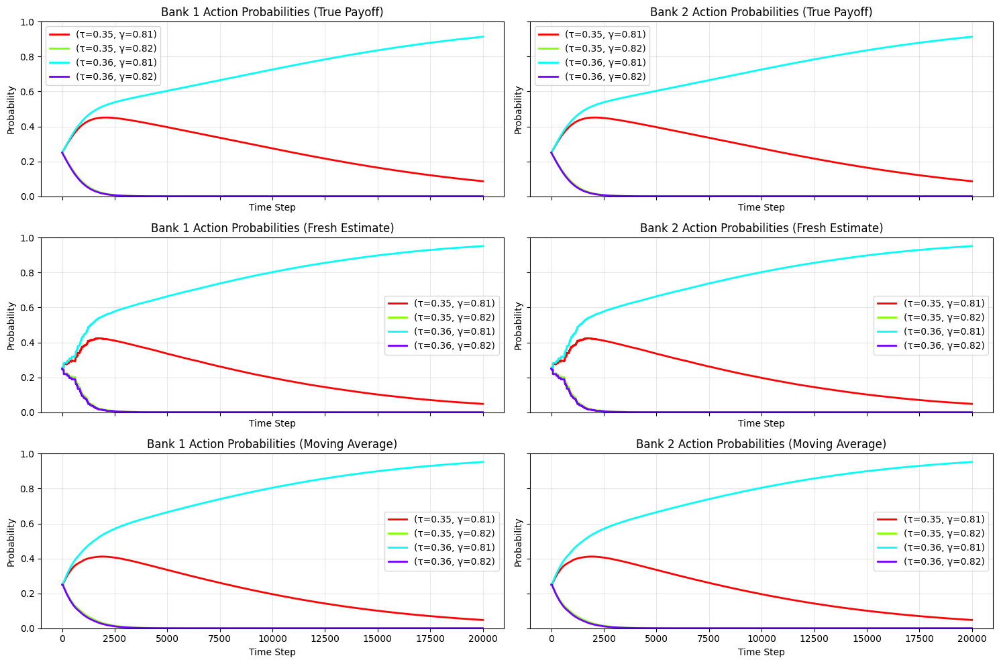

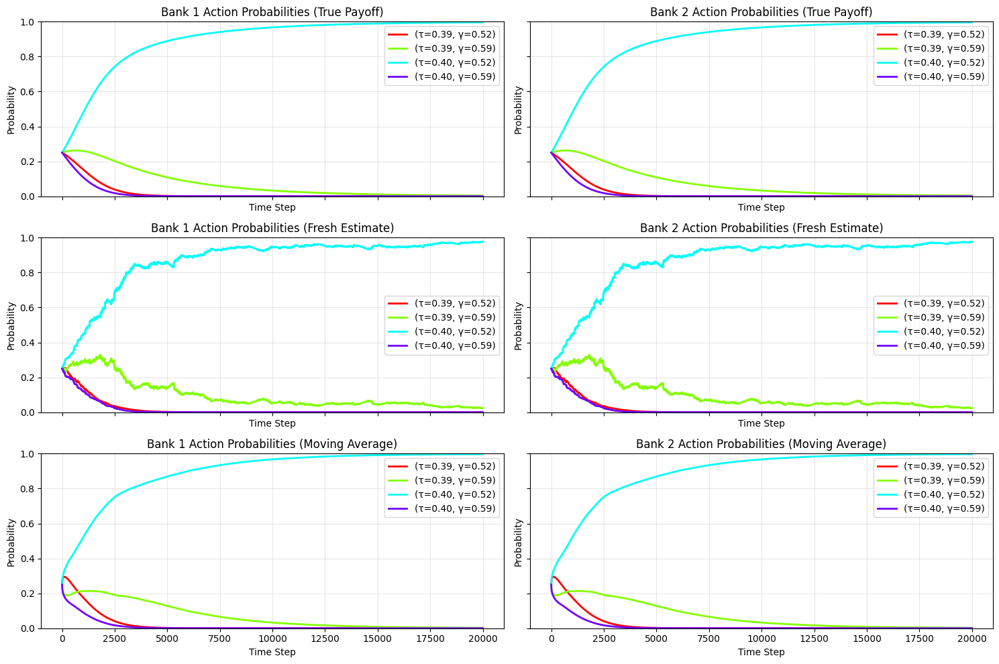

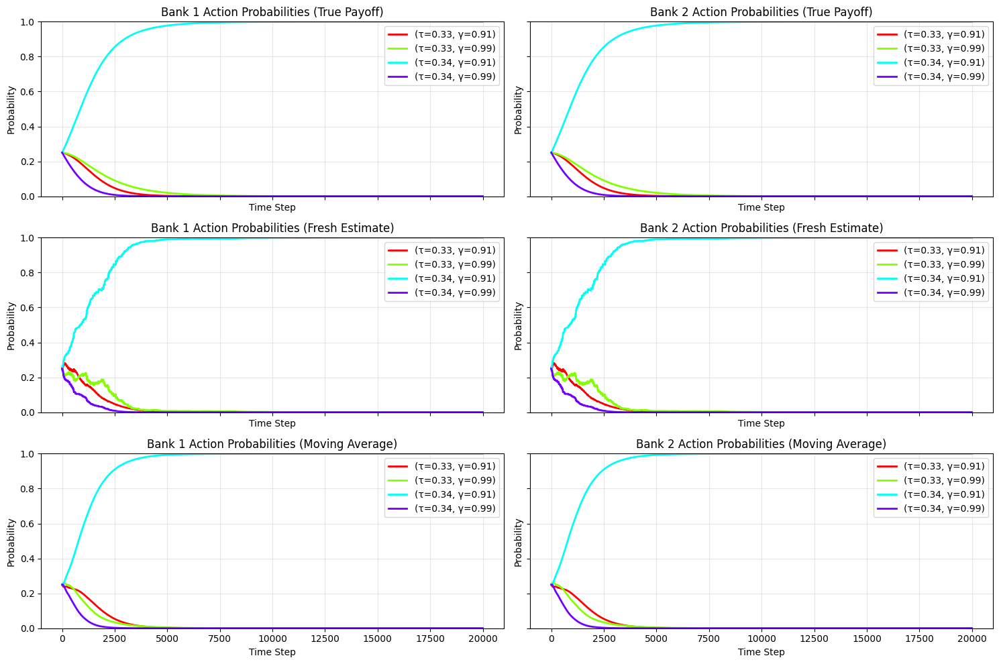

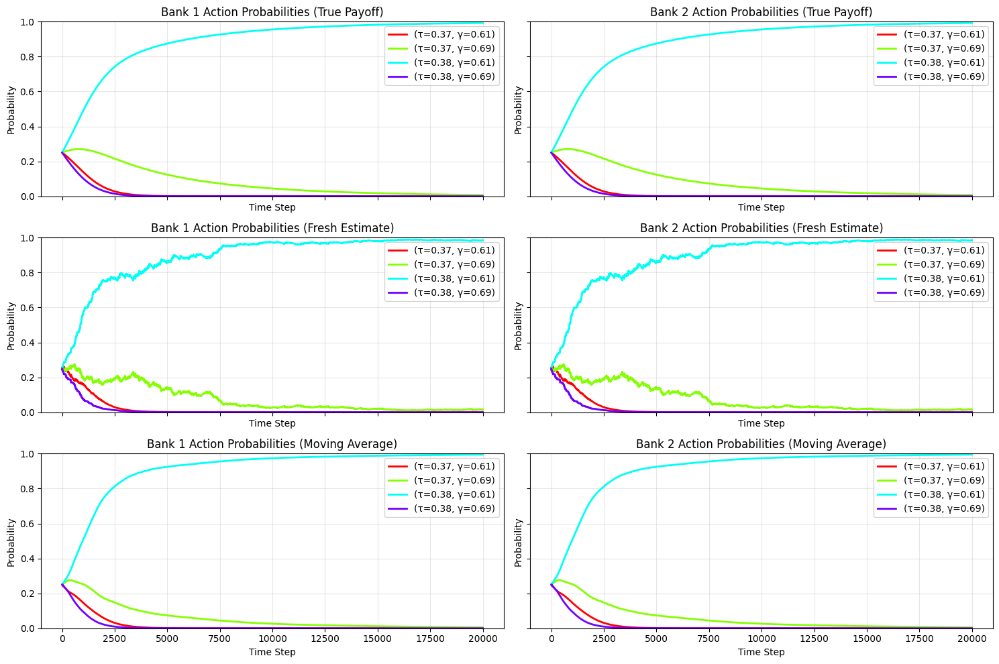

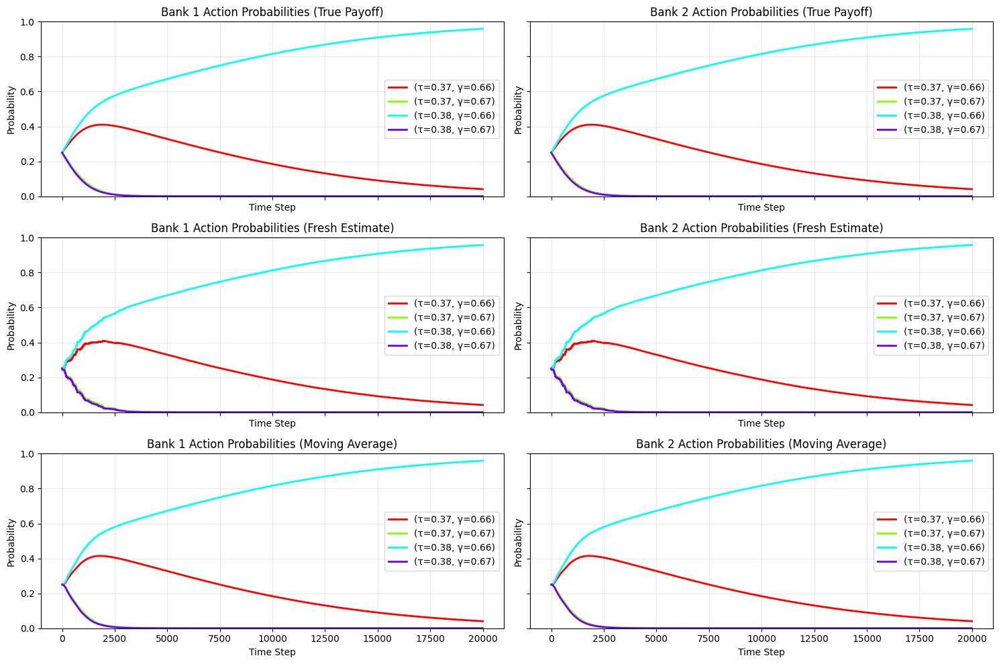

...

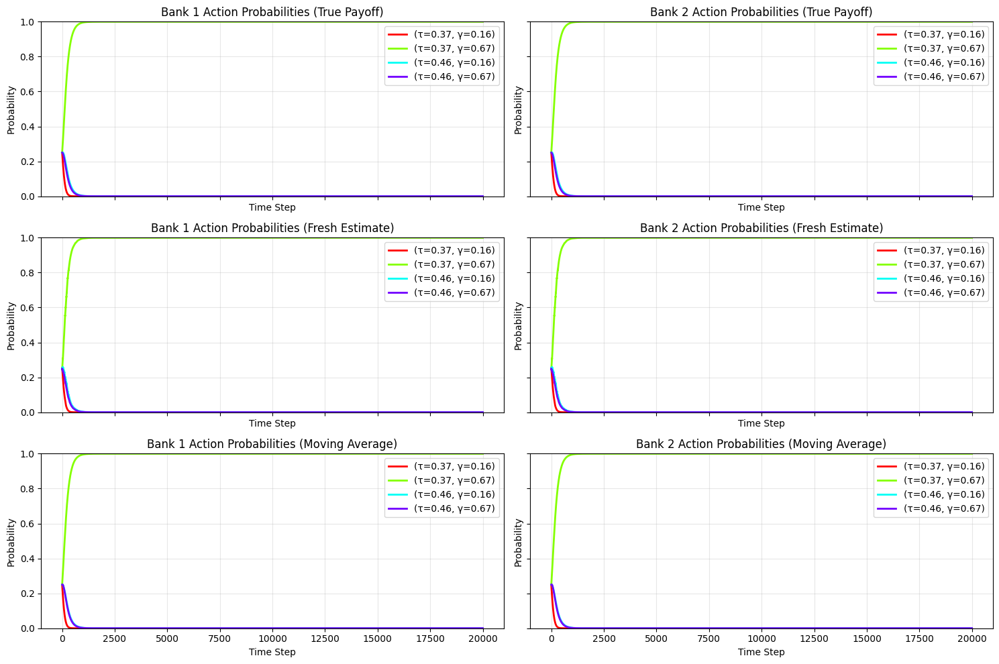

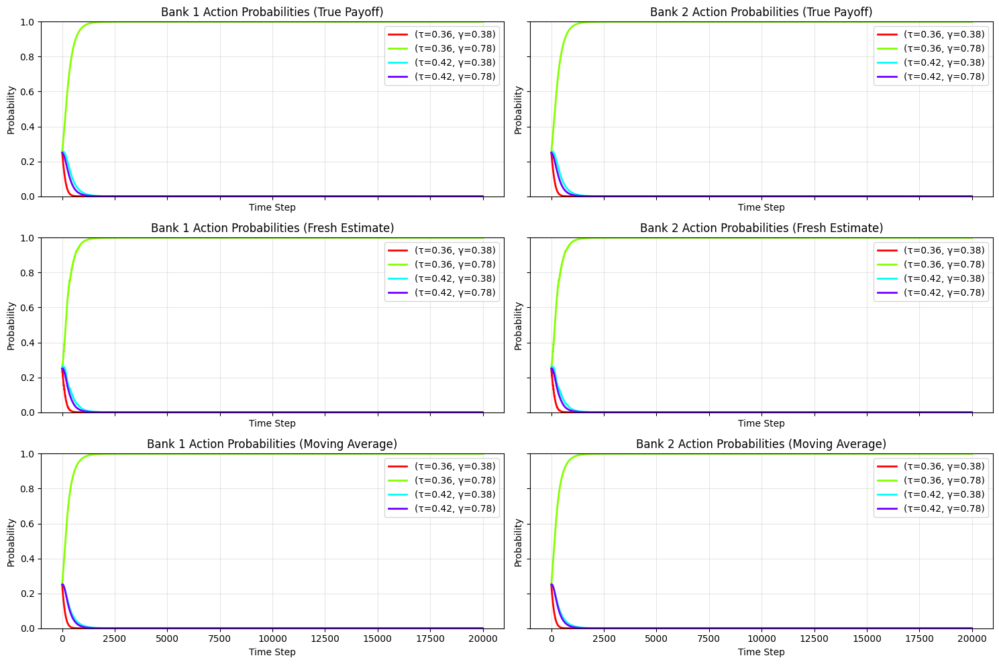

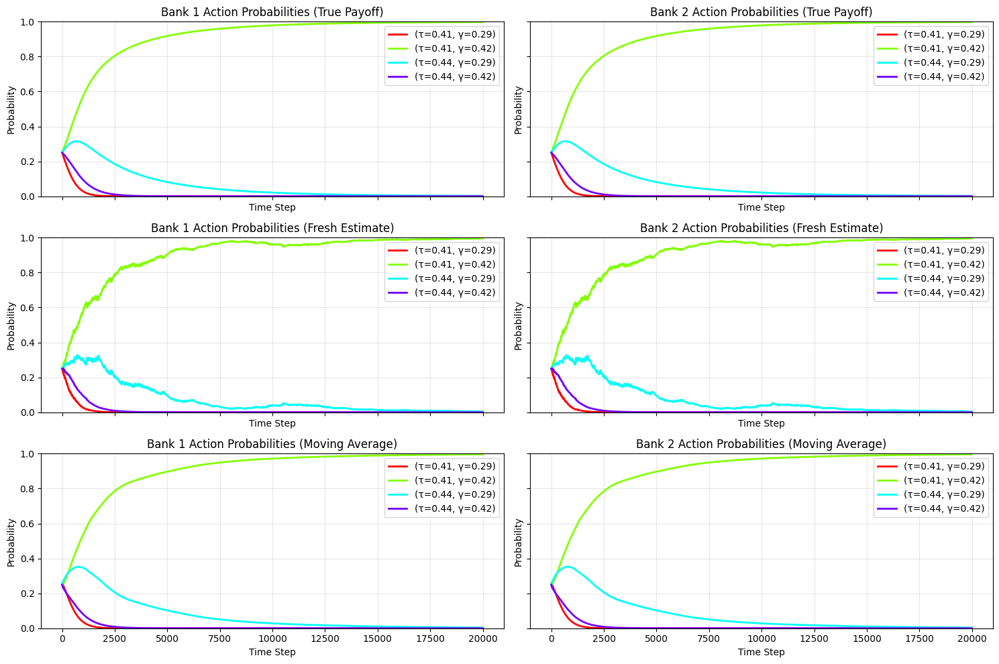

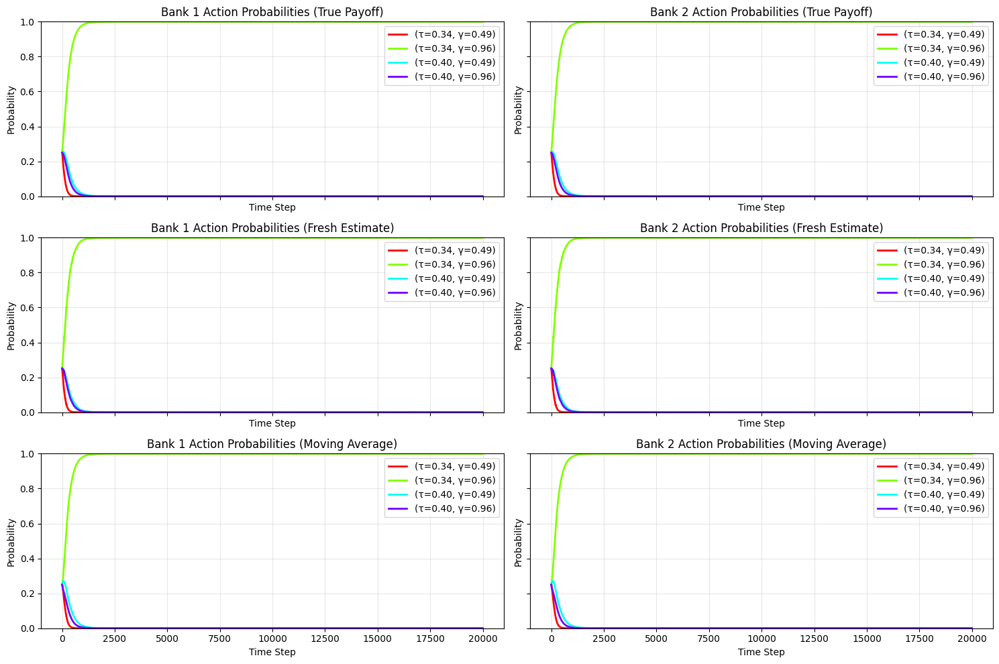

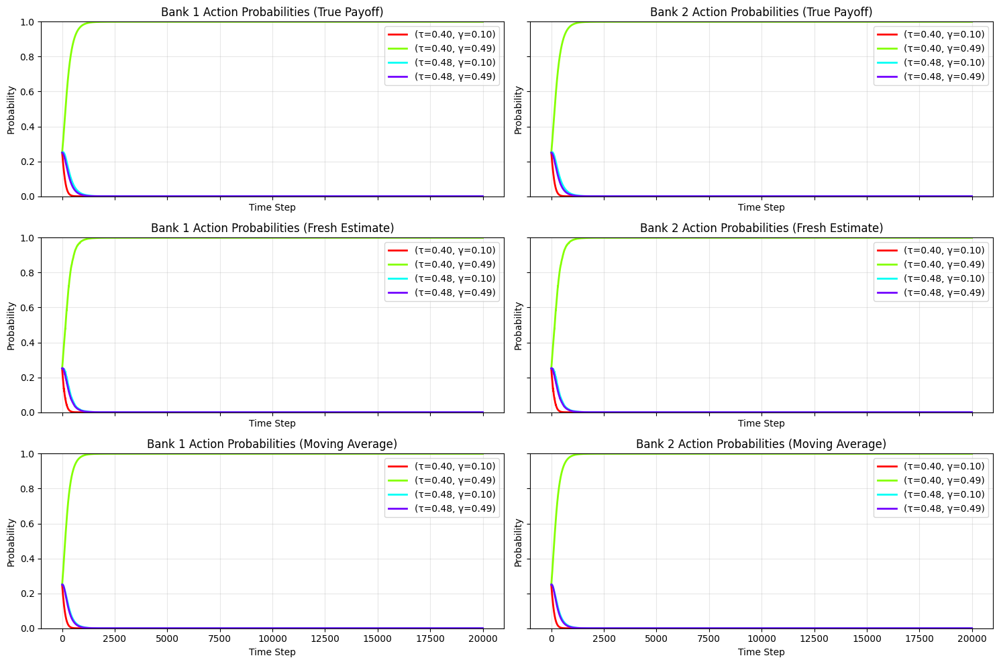

Results saved to 2x2_ExperimentResults/2x2Piecewise_results_with_images.xlsx


In [5]:
sampled_piecewiseUniform_2x2 = pd.read_csv('sampled_piecewiseUniform_2x2.csv')

# Example parameters
p_b1 = [.25,.25,.25,.25]
p_b2 = [.25,.25,.25,.25]
eta = 0.1
output_dir = "2x2_ExperimentResults"
T = 20000
fname = "2x2Piecewise_results_with_images.xlsx"

process_sampled_df(sampled_piecewiseUniform_2x2, p_b1, p_b2, eta, fname, output_dir, T)


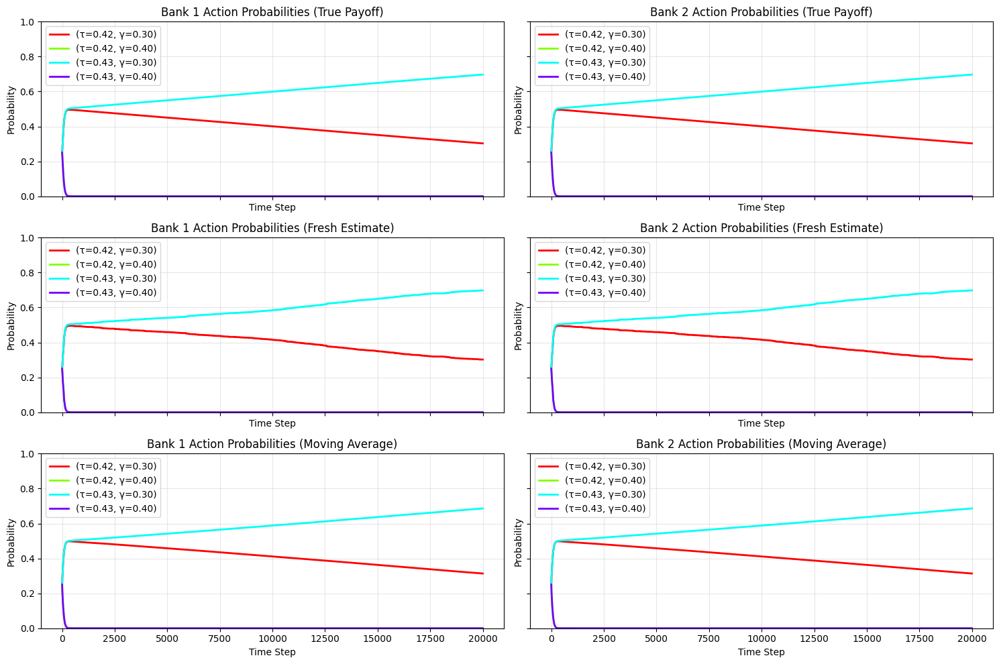

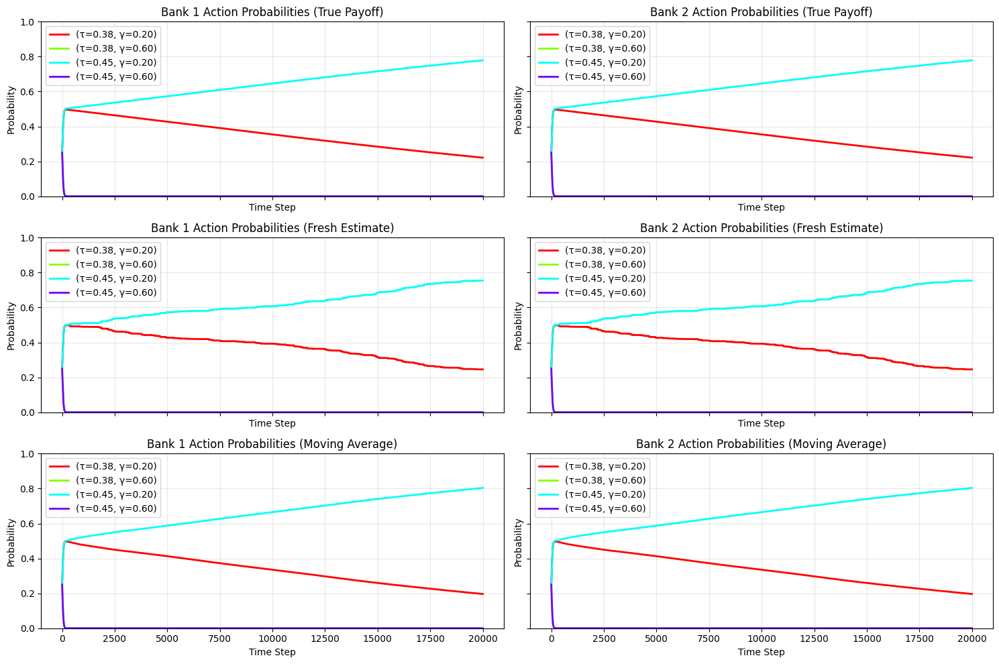

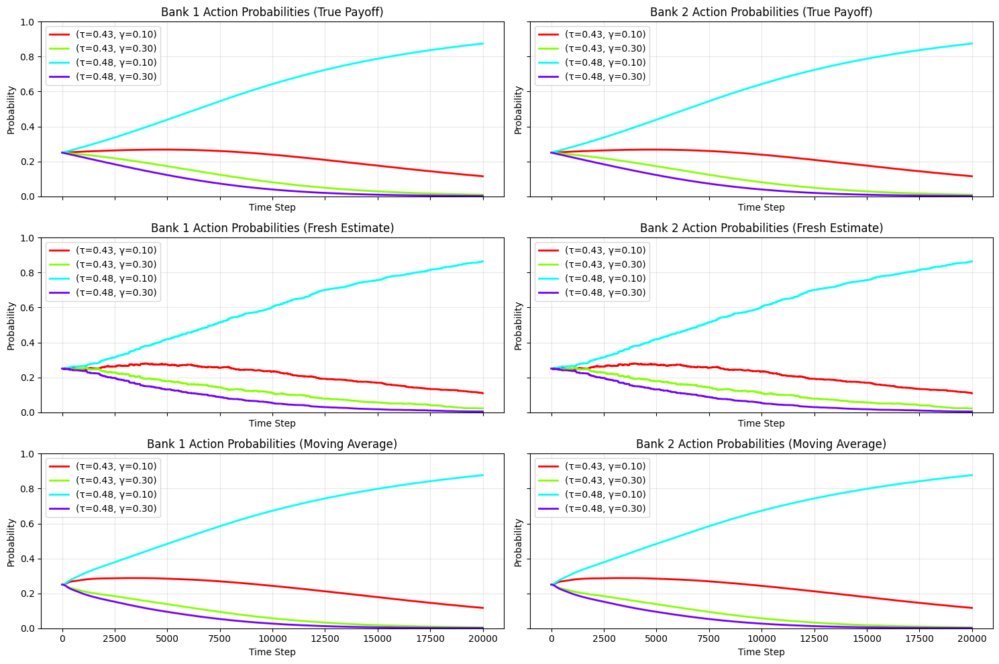

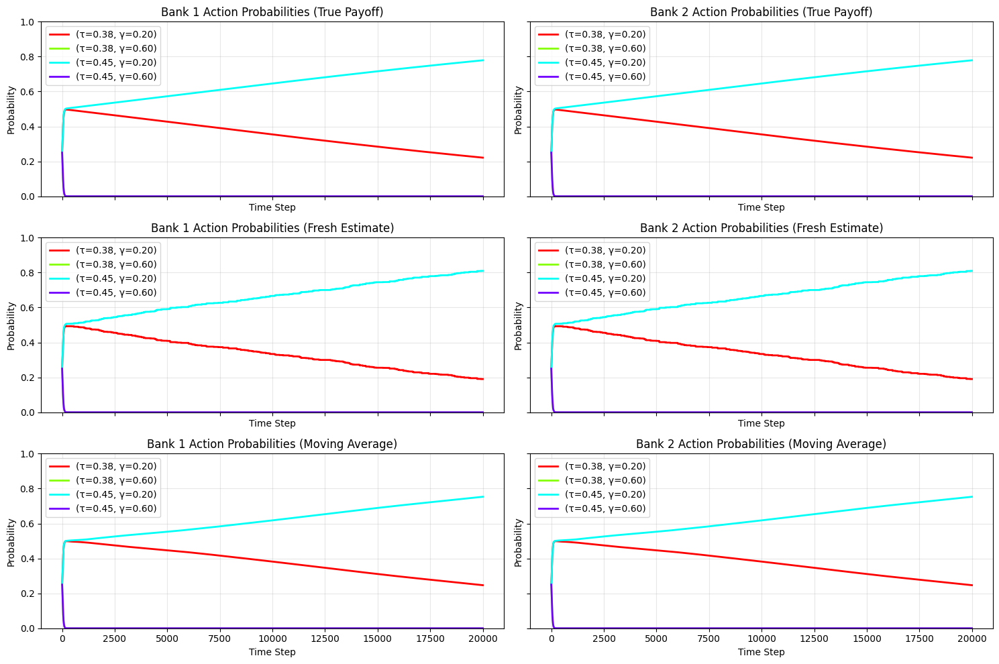

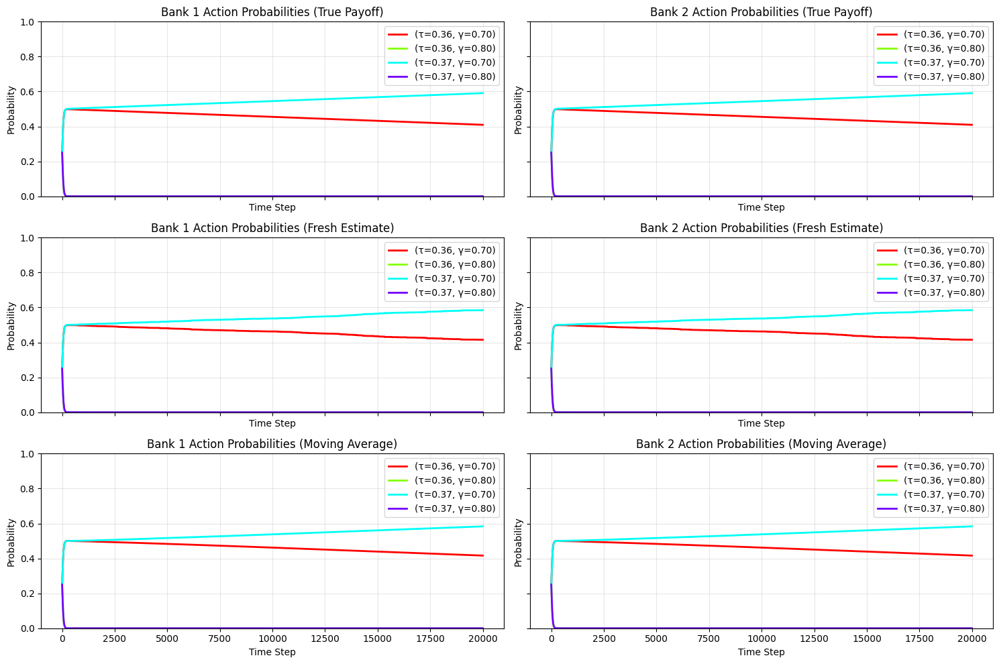

...

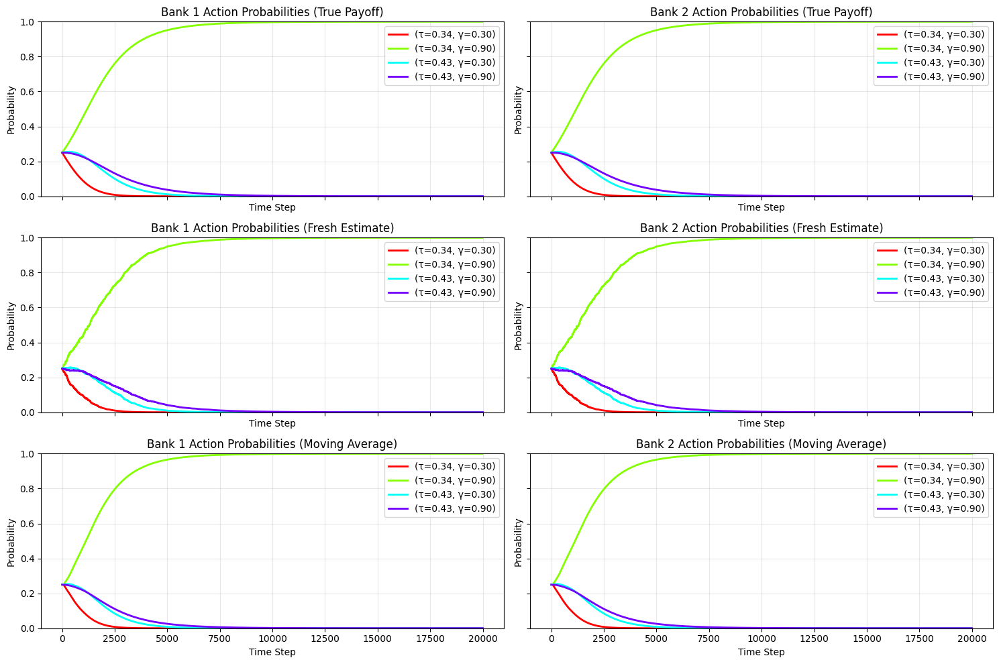

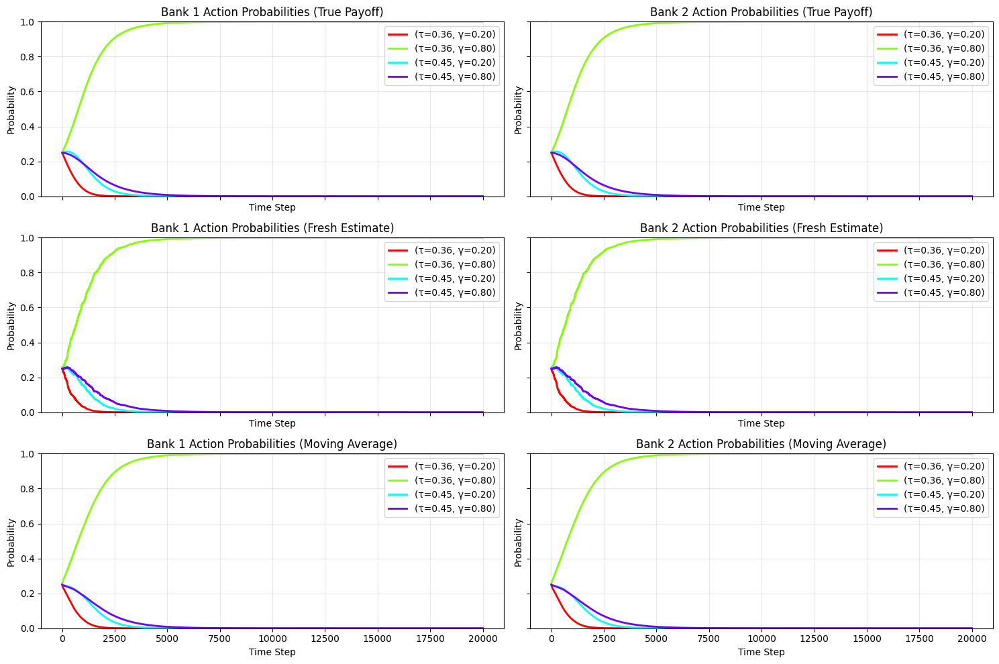

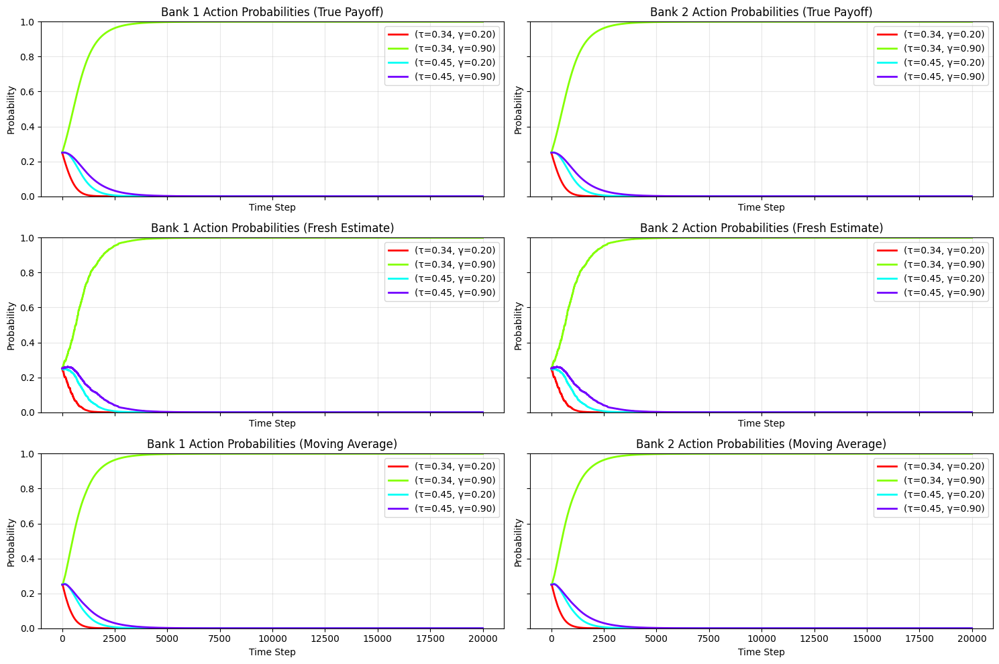

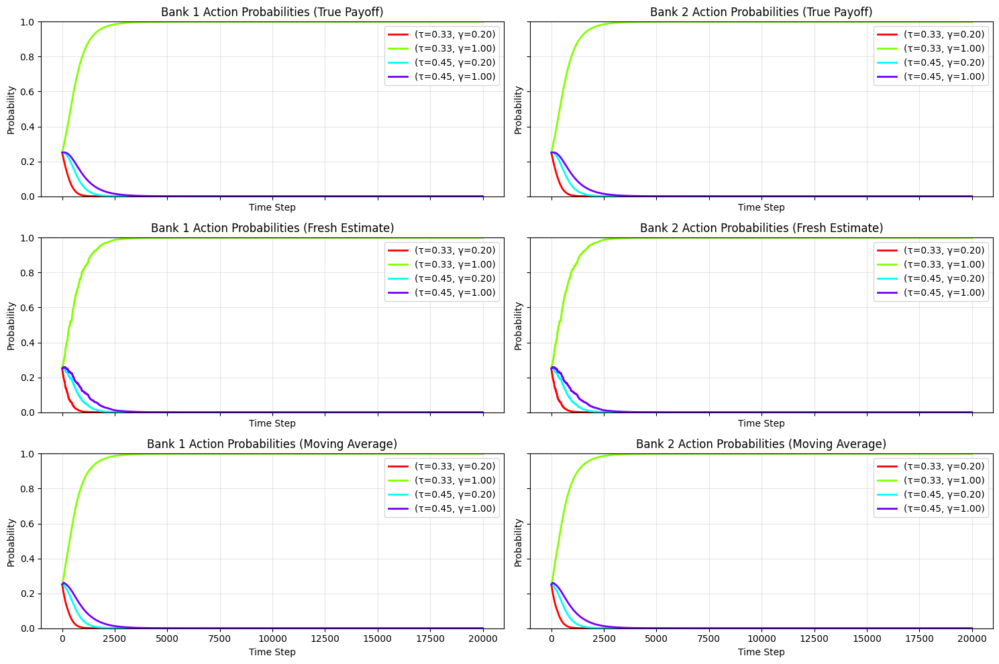

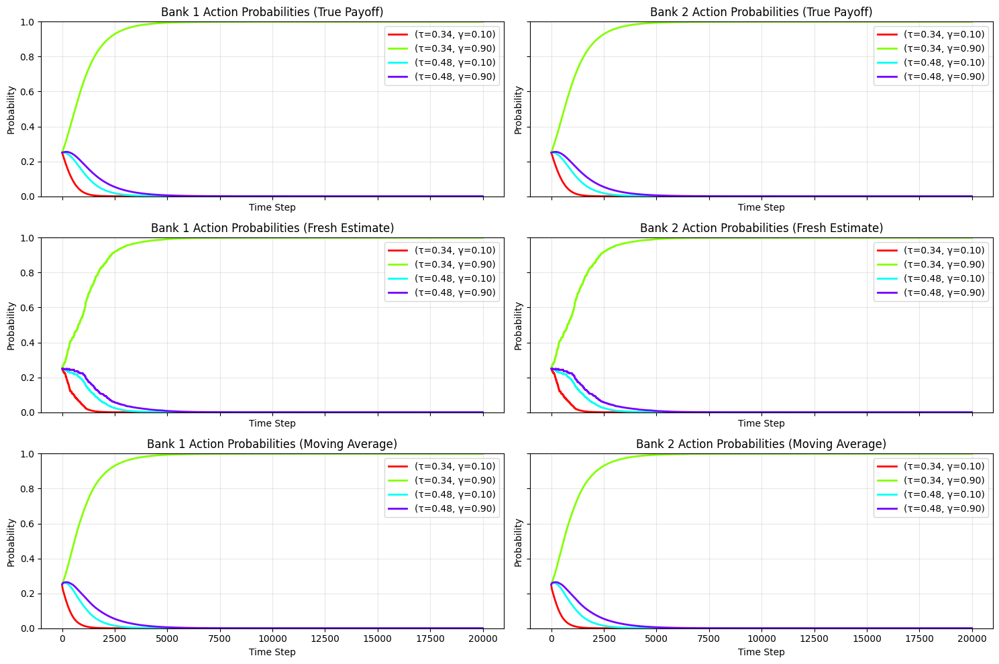

Results saved to 2x2_ExperimentResults_truncGaussian/2x2truncGaussian_results_with_images.xlsx


In [6]:
sampled_truncGaussian_2x2 = pd.read_csv('sampled_truncGaussian_2x2.csv')

# Example parameters
p_b1 = [.25,.25,.25,.25]
p_b2 = [.25,.25,.25,.25]
eta = 0.1
output_dir = "2x2_ExperimentResults_truncGaussian"
T = 20000
fname = "2x2truncGaussian_results_with_images.xlsx"

process_sampled_df(sampled_truncGaussian_2x2, p_b1, p_b2, eta, fname, output_dir, T, dist = 'tg')